In [ ]:
!sudo apt-get install python3.6

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
Note, selecting 'libcasa-python3-6' for regex 'python3.6'
Note, selecting 'libpython3.6-stdlib' for regex 'python3.6'
Note, selecting 'python3.6-2to3' for regex 'python3.6'
The following additional packages will be installed:
  libcasa-casa6
The following NEW packages will be installed:
  libcasa-casa6 libcasa-python3-6
0 upgraded, 2 newly installed, 0 to remove and 15 not upgraded.
Need to get 1,088 kB of archives.
After this operation, 4,238 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 libcasa-casa6 amd64 3.4.0-2build1 [1,000 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 libcasa-python3-6 amd64 3.4.0-2build1 [88.2 kB]
Fetched 1,088 kB in 0s (7,801 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl

In [ ]:
!sudo update-alternatives --install /usr/bin/python3 python3 /usr/bin/python3.6 1

update-alternatives: error: alternative path /usr/bin/python3.6 doesn't exist


In [ ]:
!pip uninstall scikit-learn

Found existing installation: scikit-learn 1.2.2
Uninstalling scikit-learn-1.2.2:
  Would remove:
    /usr/local/lib/python3.10/dist-packages/scikit_learn-1.2.2.dist-info/*
    /usr/local/lib/python3.10/dist-packages/scikit_learn.libs/libgomp-a34b3233.so.1.0.0
    /usr/local/lib/python3.10/dist-packages/sklearn/*
Proceed (Y/n)? Y
  Successfully uninstalled scikit-learn-1.2.2


In [ ]:
!pip install scikit-learn==0.24.2

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 23.0 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  error: subprocess-exited-with-error
  
  × Preparing metadata (pyproject.toml) did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (pyproject.toml) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.


In [ ]:
!pip install folium mapclassify contextily --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.6/20.6 MB 78.0 MB/s eta 0:00:00


In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import MinMaxScaler
from geopy.distance import geodesic
import sqlite3
from shapely.geometry import Point
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

In [ ]:
# Create your connection.
cnx = sqlite3.connect('db.sqlite3')

In [ ]:
df = pd.read_csv('/content/SA_final.csv')
scaler = MinMaxScaler()

In [ ]:
df.dropna(axis=0, how='all').shape, df.shape

((18163, 11), (18163, 11))

In [ ]:
df.head()

,lat,lon,Score,PVOUT_csi,GHI,DNI,ELE,GTI_opta,OPTA,TEMP,DIF
0,16.90874,45.34907,0.383806,1945.507324,2410.453125,2243.960938,1079,2556.453125,22.0,26.4375,847.929688
1,17.15000,43.17083,0.303104,1721.559814,2110.445312,1602.921875,789,2210.398438,20.0,26.6250,921.742188
2,17.40555,44.00693,0.377266,1940.720215,2417.242188,2331.226562,1376,2561.632812,21.0,25.0000,778.531250
3,17.10456,42.80334,0.296386,1652.457520,2068.687500,1486.117188,83,2162.351562,19.0,30.9375,1000.687500
4,17.33147,43.25468,0.313742,1717.354980,2132.757812,1713.585938,881,2246.742188,21.0,26.0625,887.539062


In [ ]:
df.describe()

,lat,lon,Score,PVOUT_csi,GHI,DNI,ELE,GTI_opta,OPTA,TEMP,DIF
count,18163.000000,18163.000000,18163.000000,18163.000000,18163.000000,18163.000000,18163.000000,18163.000000,18162.000000,18162.000000,18162.000000
mean,25.296033,43.597890,0.367055,1870.636013,2227.965098,2140.493600,645.727963,2436.838314,27.180927,25.509505,793.596768
std,3.549360,3.786493,0.022949,77.866105,80.261771,264.696732,455.368029,97.843470,3.352757,2.640438,94.195911
min,16.366670,34.571130,0.235788,1524.179565,1832.328125,1248.203125,-453.000000,1902.671875,16.000000,13.187500,444.906250
25%,23.500000,41.137885,0.359037,1826.571350,2171.597656,1953.148438,303.000000,2385.250000,26.000000,23.750000,733.765625
50%,25.916670,43.077780,0.371870,1875.181030,2229.742188,2130.640625,656.000000,2449.078125,28.000000,26.125000,812.148438
75%,27.684855,46.275515,0.380789,1922.851318,2282.015625,2309.554688,871.000000,2500.257812,29.000000,27.125000,860.423828
max,32.163000,55.500000,0.420930,2152.817383,2439.835938,3057.968750,2963.000000,2705.609375,33.000000,31.375000,1014.968750


In [ ]:
cols = ['PVOUT_csi', 'DNI', 'GHI', 'DIF','GTI_opta', 'OPTA', 'TEMP','ELE']

In [ ]:
df_normalized = df[['PVOUT_csi', 'DNI', 'GHI', 'DIF','GTI_opta', 'OPTA', 'TEMP','ELE']].copy(deep=True)
df_normalized[['PVOUT_csi', 'DNI', 'GHI',
               'DIF','GTI_opta', 'OPTA', 'TEMP', 'ELE']] = scaler.fit_transform(df_normalized)

In [ ]:
import pickle
model_pkl_file = "raghad_scaler_v1.3.2.pkl"

with open(model_pkl_file, 'wb') as file:
    pickle.dump(scaler, file)

In [ ]:
df_normalized = df_normalized.interpolate()

In [ ]:
inertias = []

for i in [1,10, 50, 100, 200, 500, 750, 1000, 1500, 2000,5000, 10000]:
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(df_normalized)
    inertias.append(kmeans.inertia_)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

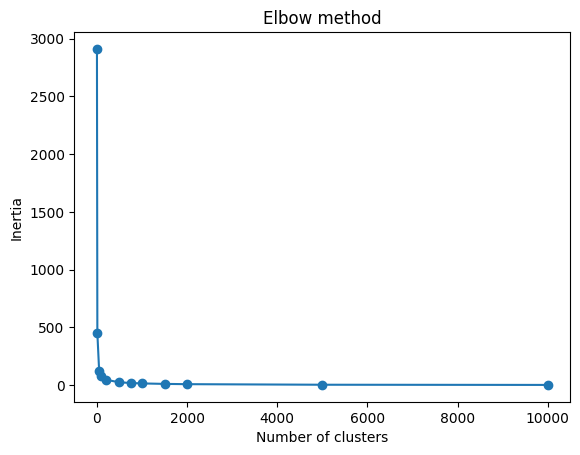

In [ ]:
plt.plot([1,10, 50, 100, 200, 500, 750, 1000, 1500, 2000,5000, 10000], inertias, marker='o')
plt.title('Elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show();

In [ ]:
inertias = []

for i in range(15, 60, 10):
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(df_normalized)
    inertias.append(kmeans.inertia_)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

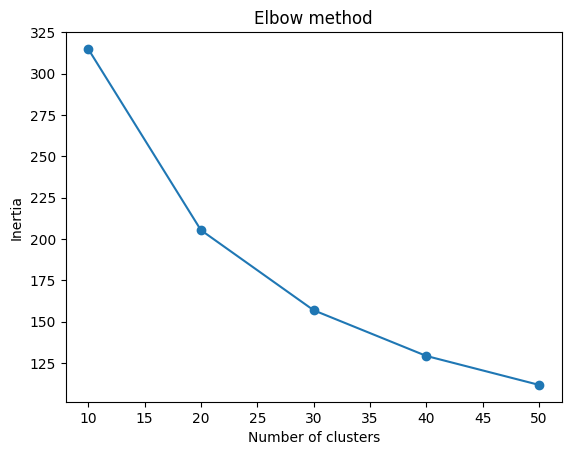

In [ ]:
plt.plot(range(10, 60, 10), inertias, marker='o')
plt.title('Elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show();

In [ ]:
kmeans = KMeans(n_clusters=20)
kmeans.fit(df_normalized)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=20)

In [ ]:
import pickle
model_pkl_file = "raghad_kmeans_20_v1.3.2.pkl"

with open(model_pkl_file, 'wb') as file:
    pickle.dump(kmeans, file)

In [ ]:
geom = gpd.points_from_xy(df['lon'], df['lat'], crs='EPSG:4326').to_crs('EPSG:4087')
gdf = gpd.GeoDataFrame(df, geometry=geom, crs=geom.crs)

In [ ]:
gdf.explore()

In [ ]:
lat, lon = 24.782284, 42.934386
p = gpd.GeoSeries(Point(lon, lat), crs='EPSG:4326').to_crs(gdf.crs)

In [ ]:
p.explore()

In [ ]:
idx_min = gdf.distance(p[0]).idxmin()
idx_min
inp = gdf.iloc[idx_min, :][cols]
inp

PVOUT_csi    1906.476196
DNI            2230.8125
GHI          2291.242188
DIF           790.929688
GTI_opta      2496.78125
OPTA                  27
TEMP                25.5
ELE                 1145
Name: 4413, dtype: object

In [ ]:
inp = scaler.transform([inp])

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(


In [ ]:
kmeans.predict(inp)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


array([13], dtype=int32)

In [ ]:
gdf['labels'] = kmeans.labels_

<Axes: >

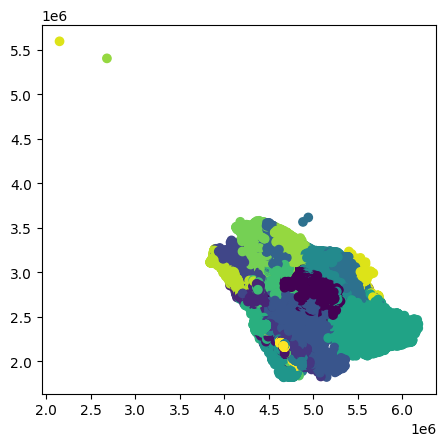

In [ ]:
gdf.plot(c=gdf['labels'])

In [ ]:
df_normalized.head()

,PVOUT_csi,DNI,GHI,DIF,GTI_opta,OPTA,TEMP,ELE
0,0.670223,0.550214,0.951634,0.706981,0.814237,0.352941,0.728522,0.448478
1,0.313981,0.196003,0.457800,0.836463,0.383251,0.235294,0.738832,0.363583
2,0.662608,0.598433,0.962809,0.585243,0.820688,0.294118,0.649485,0.535422
3,0.204057,0.131461,0.389064,0.974948,0.323412,0.176471,0.975945,0.156909
4,0.307292,0.257151,0.494528,0.776464,0.428514,0.294118,0.707904,0.390515


In [ ]:
similarity_matrix = cosine_similarity(df_normalized[['PVOUT_csi', 'DNI', 'GHI', 'DIF', 'GTI_opta',
                                                        'OPTA', 'TEMP', 'ELE']])
similarity_df = pd.DataFrame(similarity_matrix, index=df.index, columns=df.index)

In [ ]:
df.to_sql(name='sa_final', con=cnx)

27689

In [ ]:
df_normalized.to_sql(name='df_normalized', con=cnx)

27689

In [ ]:
similarity_df.shape

(27689, 27689)

In [ ]:
df.columns

Index(['lat', 'lon', 'Score', 'PVOUT_csi', 'GHI', 'DNI', 'ELE', 'GTI_opta',
       'OPTA', 'TEMP', 'DIF'],
      dtype='object')

In [ ]:
geom = gpd.points_from_xy(df['lon'], df['lat'], crs='EPSG:4326')
gdf = gpd.GeoDataFrame(df, geometry=geom, crs=geom.crs)

In [ ]:
gdf.explore()

In [ ]:
lat =27.455
lon = 35.275
s = '{"$schema": "https://proj.org/schemas/v0.5/projjson.schema.json","type": "ProjectedCRS","name": "WGS 84 / UTM zone 37N","base_crs": {"name": "WGS 84","datum_ensemble": {"name": "World Geodetic System 1984 ensemble","members": [{"name": "World Geodetic System 1984 (Transit)","id": {"authority": "EPSG","code": 1166}},{"name": "World Geodetic System 1984 (G730)","id": {"authority": "EPSG","code": 1152}},{"name": "World Geodetic System 1984 (G873)","id": {"authority": "EPSG","code": 1153}},{"name": "World Geodetic System 1984 (G1150)","id": {"authority": "EPSG","code": 1154}},{"name": "World Geodetic System 1984 (G1674)","id": {"authority": "EPSG","code": 1155}},{"name": "World Geodetic System 1984 (G1762)","id": {"authority": "EPSG","code": 1156}},{"name": "World Geodetic System 1984 (G2139)","id": {"authority": "EPSG","code": 1309}}],"ellipsoid": {"name": "WGS 84","semi_major_axis": 6378137,"inverse_flattening": 298.257223563},"accuracy": "2.0","id": {"authority": "EPSG","code": 6326}},"coordinate_system": {"subtype": "ellipsoidal","axis": [{"name": "Geodetic latitude","abbreviation": "Lat","direction": "north","unit": "degree"},{"name": "Geodetic longitude","abbreviation": "Lon","direction": "east","unit": "degree"}]},"id": {"authority": "EPSG","code": 4326}},"conversion": {"name": "UTM zone 37N","method": {"name": "Transverse Mercator","id": {"authority": "EPSG","code": 9807}},"parameters": [{"name": "Latitude of natural origin","value": 0,"unit": "degree","id": {"authority": "EPSG","code": 8801}},{"name": "Longitude of natural origin","value": 39,"unit": "degree","id": {"authority": "EPSG","code": 8802}},{"name": "Scale factor at natural origin","value": 0.9996,"unit": "unity","id": {"authority": "EPSG","code": 8805}},{"name": "False easting","value": 500000,"unit": "metre","id": {"authority": "EPSG","code": 8806}},{"name": "False northing","value": 0,"unit": "metre","id": {"authority": "EPSG","code": 8807}}]},"coordinate_system": {"subtype": "Cartesian","axis": [{"name": "Easting","abbreviation": "E","direction": "east","unit": "metre"},{"name": "Northing","abbreviation": "N","direction": "north","unit": "metre"}]},"scope": "Engineering survey, topographic mapping.","area": "Between 36°E and 42°E, northern hemisphere between equator and 84°N, onshore and offshore. Djibouti. Egypt. Eritrea. Ethiopia. Georgia. Iraq. Jordan. Kenya. Lebanon. Russian Federation. Saudi Arabia. Somalia. Sudan. Syria. Turkey. Ukraine.","bbox": {"south_latitude": 0,"west_longitude": 36,"north_latitude": 84,"east_longitude": 42},"id": {"authority": "EPSG","code": 32637}}'

p = gpd.GeoSeries(Point(lon,lat), crs='EPSG:4326').to_crs('EPSG:3857')
index_of_nearest = gdf.to_crs(p.crs).distance(p[0]).idxmin()
nearest_location = gdf.iloc[index_of_nearest, :]
nearest_lat, nearest_lon =  nearest_location['lat'], nearest_location['lon']
nearest_lat, nearest_lon


(27.6525, 35.27886)

22045